In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime

# Set figure size for better visibility
plt.figure(figsize=(30, 200))  # Adjust size as needed

print(f"[{datetime.now().strftime('%H:%M:%S')}] 시각화 시작...")

# Create a dictionary to store feature data
feature_data = {}

# First pass: collect all feature names
print(f"[{datetime.now().strftime('%H:%M:%S')}] Feature 목록 수집 중...")
first_df = pd.read_parquet(f'jane-street-real-time-market-data-forecasting/train.parquet/partition_id=0/part-0.parquet')
feature_cols = first_df.columns[first_df.columns.str.contains("feature")].to_list() + ["responder_1", "responder_2","responder_3","responder_4","responder_5", "responder_6"]
print(f"[{datetime.now().strftime('%H:%M:%S')}] 총 {len(feature_cols)}개의 feature 발견")
del first_df

# Calculate grid dimensions
n_features = len(feature_cols)
n_partitions = 10

# Process each partition
print(f"[{datetime.now().strftime('%H:%M:%S')}] Partition 데이터 처리 시작...")
for partition_num in range(n_partitions):
    print(f"[{datetime.now().strftime('%H:%M:%S')}] Partition {partition_num+1}/{n_partitions} 처리 중...")
    
    # Read partition data
    df = pd.read_parquet(f'jane-street-real-time-market-data-forecasting/train.parquet/partition_id={partition_num}/part-0.parquet')
    
    # Calculate time-based means
    target_cols = feature_cols + ["time_id", "responder_1", "responder_2","responder_3","responder_4","responder_5", "responder_6"]
    time_df = df[target_cols].groupby('time_id').mean()
    
    # Store data for each feature
    for feature in feature_cols:
        if feature not in feature_data:
            feature_data[feature] = {}
        feature_data[feature][partition_num] = time_df[feature]
    
    # Clean up memory
    del df
    del time_df

print(f"[{datetime.now().strftime('%H:%M:%S')}] 그래프 그리기 시작...")

# Create subplots
total_plots = n_features * n_partitions
plots_done = 0

for feature_idx, feature in enumerate(feature_cols):
    if (feature_idx + 1) % 10 == 0:  # 10개의 feature마다 진행상황 출력
        print(f"[{datetime.now().strftime('%H:%M:%S')}] Feature 처리 중... ({feature_idx+1}/{n_features})")
    
    for partition_num in range(n_partitions):
        # Calculate subplot position (features as rows, partitions as columns)
        plt.subplot(n_features, n_partitions, feature_idx * n_partitions + partition_num + 1)
        
        # Plot the data
        plt.plot(feature_data[feature][partition_num])
        
        # Add titles and labels
        if partition_num == 0:  # Only add feature name on the leftmost plot
            plt.ylabel(feature, rotation=0, ha='right')
        if feature_idx == 0:  # Only add partition number on the top row
            plt.title(f'P{partition_num}')
        
        # Remove x-axis labels to save space
        plt.xticks([])
        
        # Remove y-axis labels for all but leftmost plots
        if partition_num != 0:
            plt.yticks([])
        
        plots_done += 1

print(f"[{datetime.now().strftime('%H:%M:%S')}] 레이아웃 조정 중...")
# Adjust layout to prevent overlap
plt.tight_layout()

print(f"[{datetime.now().strftime('%H:%M:%S')}] 그래프 표시 중...")
plt.show()

# Clean up memory
print(f"[{datetime.now().strftime('%H:%M:%S')}] 메모리 정리 중...")
del feature_data

print(f"[{datetime.now().strftime('%H:%M:%S')}] 작업 완료!")

[11:14:44] 시각화 시작...
[11:14:44] Feature 목록 수집 중...
[11:14:44] 총 85개의 feature 발견
[11:14:44] Partition 데이터 처리 시작...
[11:14:44] Partition 1/10 처리 중...
[11:14:45] Partition 2/10 처리 중...
[11:14:46] Partition 3/10 처리 중...
[11:14:47] Partition 4/10 처리 중...
[11:14:49] Partition 5/10 처리 중...
[11:14:51] Partition 6/10 처리 중...
[11:14:54] Partition 7/10 처리 중...
[11:14:57] Partition 8/10 처리 중...
[11:15:01] Partition 9/10 처리 중...
[11:15:05] Partition 10/10 처리 중...
[11:15:09] 그래프 그리기 시작...
[11:15:09] Feature 처리 중... (10/85)
[11:15:11] Feature 처리 중... (20/85)
[11:15:12] Feature 처리 중... (30/85)
[11:15:13] Feature 처리 중... (40/85)
[11:15:14] Feature 처리 중... (50/85)
[11:15:14] Feature 처리 중... (60/85)
[11:15:15] Feature 처리 중... (70/85)
[11:15:16] Feature 처리 중... (80/85)
[11:15:17] 레이아웃 조정 중...
[11:15:19] 그래프 표시 중...


[11:15:26] 메모리 정리 중...
[11:15:26] 작업 완료!


In [5]:

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from datetime import datetime

# Set figure size - 가로 크기를 더 크게 조정
plt.figure(figsize=(50, 200))  # 가로 크기를 30에서 50으로 증가

print(f"[{datetime.now().strftime('%H:%M:%S')}] 시각화 시작...")

# Read single parquet file
df = pd.read_parquet(f'jane-street-real-time-market-data-forecasting/train.parquet/partition_id=6/part-0.parquet')

# Get feature columns and symbols
feature_cols = df.columns[df.columns.str.contains("feature")].to_list() + ["responder_1", "responder_2", "responder_3", "responder_4", "responder_5", "responder_6"]
symbols = df['symbol_id'].unique()

n_features = len(feature_cols)
n_symbols = len(symbols)

print(f"[{datetime.now().strftime('%H:%M:%S')}] 데이터 처리 시작...")
print(f"Features: {n_features}, Symbols: {n_symbols}")

# Efficient groupby for all symbols at once
grouped_data = df.groupby(['symbol_id', 'time_id'])[feature_cols].mean()

print(f"[{datetime.now().strftime('%H:%M:%S')}] 그래프 그리기 시작...")

# 서브플롯 간격 조정
plt.subplots_adjust(wspace=0.3, hspace=0.3)  # 서브플롯 간 간격 증가

# Plot data
for feature_idx, feature in enumerate(feature_cols):
    if (feature_idx + 1) % 10 == 0:
        print(f"[{datetime.now().strftime('%H:%M:%S')}] Feature 처리 중... ({feature_idx+1}/{n_features})")
    
    for symbol_idx, symbol in enumerate(symbols):
        # Plot position: features as rows, symbols as columns
        plt.subplot(n_features, n_symbols, feature_idx * n_symbols + symbol_idx + 1)
        
        # Plot the data
        symbol_data = grouped_data.loc[symbol][feature]
        plt.plot(symbol_data)
        
        # Add text annotations for specific features
        if feature in ['feature_09', 'feature_10', 'feature_11']:
            plt.text(0.5, 0.5, feature, 
                    horizontalalignment='center',
                    verticalalignment='center',
                    transform=plt.gca().transAxes)
        
        # Add labels
        if symbol_idx == 0:  # Leftmost plot
            plt.ylabel(feature, rotation=0, ha='right')
        if feature_idx == 0:  # Top row
            plt.title(f'Symbol {symbol}')
        
        # Remove x-axis labels
        plt.xticks([])
        
        # Remove y-axis labels except leftmost plots
        if symbol_idx != 0:
            plt.yticks([])

print(f"[{datetime.now().strftime('%H:%M:%S')}] 레이아웃 조정 중...")
plt.tight_layout()

print(f"[{datetime.now().strftime('%H:%M:%S')}] 그래프 표시 중...")
plt.show()

print(f"[{datetime.now().strftime('%H:%M:%S')}] 메모리 정리 및 작업 완료!")
del grouped_data, df

[14:46:24] 시각화 시작...
[14:46:25] 데이터 처리 시작...
Features: 85, Symbols: 39
[14:46:27] 그래프 그리기 시작...
[14:46:29] Feature 처리 중... (10/85)
[14:46:37] Feature 처리 중... (20/85)
[14:46:41] Feature 처리 중... (30/85)
[14:46:45] Feature 처리 중... (40/85)
[14:46:49] Feature 처리 중... (50/85)
[14:46:54] Feature 처리 중... (60/85)
[14:46:59] Feature 처리 중... (70/85)
[14:47:03] Feature 처리 중... (80/85)
[14:47:05] 레이아웃 조정 중...
[14:47:12] 그래프 표시 중...


[14:47:35] 메모리 정리 및 작업 완료!


In [27]:
import pandas as pd 
df_5 = pd.read_parquet(f'jane-street-real-time-market-data-forecasting/train.parquet/partition_id=5/part-0.parquet')
df_6 = pd.read_parquet(f'jane-street-real-time-market-data-forecasting/train.parquet/partition_id=6/part-0.parquet')

In [2]:
time_df = pd.read_parquet(f'jane-street-real-time-market-data-forecasting/train.parquet/partition_id=5/part-0.parquet')
time_df = time_df.groupby("time_id").mean()

In [8]:
feature_cols = [col for col in df.columns if col.startswith('feature_')]
    
    
# time_id를 인덱스로 사용하여 feature 값들만 추출
seasonal_patterns = time_df[feature_cols]
    
# df의 time_id를 인덱스로 사용하여 계절성 값을 매핑하고 차감
df[feature_cols] = df[feature_cols].values - seasonal_patterns.iloc[df['time_id']].values

: 

In [ ]:
df

,date_id,time_id,symbol_id,weight,feature_00,feature_01,feature_02,feature_03,feature_04,feature_05,...,feature_78,responder_0,responder_1,responder_2,responder_3,responder_4,responder_5,responder_6,responder_7,responder_8
0,1020,0,0,2.679878,0.067313,-1.482604,-0.180323,0.125755,0.351710,0.597167,...,-1.161346,0.057490,-0.020380,0.151817,1.176065,-0.683896,1.222135,1.822080,-0.699136,2.865153
1,1020,0,1,4.407496,0.104684,-1.817611,-0.033589,0.402978,0.473560,0.513458,...,-1.174574,-0.214946,-0.036094,-0.036046,0.525263,-0.434739,1.235148,0.914796,-0.717382,0.643339
2,1020,0,2,2.821721,-0.344475,-1.373443,0.257626,0.142803,0.316221,0.690244,...,-0.996528,-0.441242,-0.281995,0.155182,-1.106123,-0.771560,-0.464858,-0.793521,-0.717857,-1.547887
3,1020,0,3,1.700922,-0.280287,-1.071721,0.441774,0.511812,0.783767,0.438144,...,0.203624,0.246010,0.362785,0.000741,0.304133,-0.598776,0.545253,0.198089,-1.289874,0.688991
4,1020,0,4,2.232697,0.490317,-1.332342,0.331396,0.610744,0.581934,0.366264,...,-0.120318,-0.473040,-0.140053,-1.146351,0.145259,-0.030338,-1.370866,0.328847,0.035067,-1.773254
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6203907,1189,967,34,2.289930,1.072669,0.990538,1.285525,1.365904,2.061171,0.013849,...,-0.292214,-0.025761,0.708826,0.394135,-0.166787,-0.089152,0.329346,0.006158,0.024142,0.002187
6203908,1189,967,35,1.412874,1.153315,0.659326,1.201995,1.432678,1.703147,0.038454,...,-0.294813,-2.016861,0.079472,-0.846160,-0.982624,-0.541104,0.639480,0.120428,0.112595,0.235896
6203909,1189,967,36,1.500883,1.316286,0.810218,1.293663,0.769859,1.897686,-0.058420,...,-0.300495,0.029016,-0.243182,-0.582336,0.453943,0.207659,-0.967886,-0.119408,-0.017954,-0.174981
6203910,1189,967,37,0.688564,1.269444,1.156976,1.639323,0.951040,1.891539,0.015732,...,0.011257,-0.346496,0.035098,-0.222864,0.421047,0.164405,-0.115973,-0.271915,-0.125812,-0.556801


In [10]:
seasonal_diff_df = df.groupby("time_id").mean()

<Axes: xlabel='time_id'>

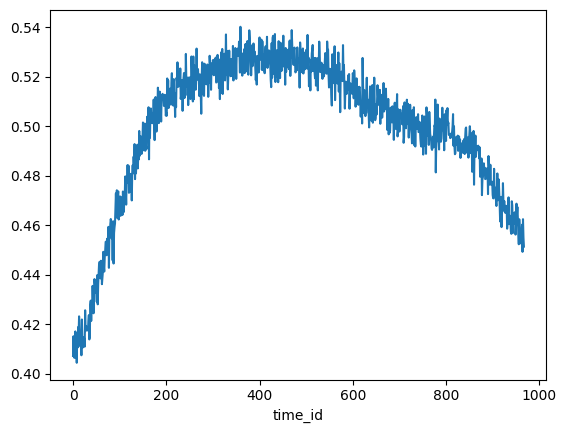

In [13]:
seasonal_diff_df.feature_00.plot()

In [76]:
print("feature_09 unique: ",df['feature_09'].unique())
print("feature_10 unique: ",df['feature_10'].unique())
print("feature_11 unique: ",df['feature_11'].unique())

feature_09 unique:  [11 81  4 15  2 42 46 70 50 44  9 64 30 34 14 57 26 68 12 82]
feature_10 unique:  [ 7  2  3  1 10  5  6  4 12]
feature_11 unique:  [ 76  59  11   9 171  62 150 261 410 522  16  25 376  50 214  13  40 230
 158 336 534  24 388  63  48  66 539]


In [89]:
df.loc[(df['feature_10'] == 7)]["symbol_id"].unique()

array([ 0,  1,  7,  9, 12, 16, 35, 33], dtype=int8)

In [88]:
df.loc[(df['feature_10'] == 7)]["feature_09"].unique()

array([11, 70], dtype=int8)

In [87]:
df.loc[(df['feature_10'] == 7)]["feature_11"].unique()

array([ 76, 410], dtype=int16)

In [120]:
df.loc[(df['symbol_id'] == 0)][["feature_09", "feature_10", "feature_11"]]

,feature_09,feature_10,feature_11
0,11,7,76
34,11,7,76
68,11,7,76
102,11,7,76
136,11,7,76
...,...,...,...
6203717,11,7,76
6203756,11,7,76
6203795,11,7,76
6203834,11,7,76


In [73]:
df.loc[(df['symbol_id'] == 12)][["feature_09", "feature_10", "feature_11"]]

,feature_09,feature_10,feature_11
11,70,7,410
45,70,7,410
79,70,7,410
113,70,7,410
147,70,7,410
...,...,...,...
6203729,70,7,410
6203768,70,7,410
6203807,70,7,410
6203846,70,7,410


In [64]:
df

,date_id,time_id,symbol_id,weight,feature_00,feature_01,feature_02,feature_03,feature_04,feature_05,...,feature_78,responder_0,responder_1,responder_2,responder_3,responder_4,responder_5,responder_6,responder_7,responder_8
0,1020,0,0,2.679878,-0.151614,-1.218194,-0.584913,-0.129442,1.564324,0.367270,...,-0.315150,0.057490,-0.020380,0.151817,1.176065,-0.683896,1.222135,1.822080,-0.699136,2.865153
1,1020,0,1,4.407496,-0.114243,-1.553200,-0.438179,0.147782,1.686174,0.283562,...,-0.328378,-0.214946,-0.036094,-0.036046,0.525263,-0.434739,1.235148,0.914796,-0.717382,0.643339
2,1020,0,2,2.821721,-0.563401,-1.109032,-0.146964,-0.112394,1.528836,0.460348,...,-0.150332,-0.441242,-0.281995,0.155182,-1.106123,-0.771560,-0.464858,-0.793521,-0.717857,-1.547887
3,1020,0,3,1.700922,-0.499214,-0.807310,0.037185,0.256615,1.996381,0.208247,...,1.049820,0.246010,0.362785,0.000741,0.304133,-0.598776,0.545253,0.198089,-1.289874,0.688991
4,1020,0,4,2.232697,0.271390,-1.067931,-0.073194,0.355548,1.794548,0.136368,...,0.725878,-0.473040,-0.140053,-1.146351,0.145259,-0.030338,-1.370866,0.328847,0.035067,-1.773254
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6203907,1189,967,34,2.289930,0.739135,0.467176,1.007928,1.080141,1.768693,-0.137812,...,-0.243023,-0.025761,0.708826,0.394135,-0.166787,-0.089152,0.329346,0.006158,0.024142,0.002187
6203908,1189,967,35,1.412874,0.819782,0.135963,0.924399,1.146915,1.410669,-0.113207,...,-0.245622,-2.016861,0.079472,-0.846160,-0.982624,-0.541104,0.639480,0.120428,0.112595,0.235896
6203909,1189,967,36,1.500883,0.982752,0.286856,1.016067,0.484095,1.605208,-0.210081,...,-0.251305,0.029016,-0.243182,-0.582336,0.453943,0.207659,-0.967886,-0.119408,-0.017954,-0.174981
6203910,1189,967,37,0.688564,0.935910,0.633613,1.361726,0.665276,1.599061,-0.135930,...,0.060448,-0.346496,0.035098,-0.222864,0.421047,0.164405,-0.115973,-0.271915,-0.125812,-0.556801


In [70]:
df.groupby(["symbol_id"]).max().time_id

symbol_id
0     967
1     967
2     967
3     967
4     967
5     967
6     967
7     967
8     967
9     967
10    967
11    967
12    967
13    967
14    967
15    967
16    967
17    967
18    967
19    967
20    967
21    967
22    967
23    967
24    967
25    967
26    967
27    967
28    967
29    967
30    967
31    967
32    967
33    967
34    967
35    967
36    967
37    967
38    967
Name: time_id, dtype: int16

<Axes: xlabel='time_id'>

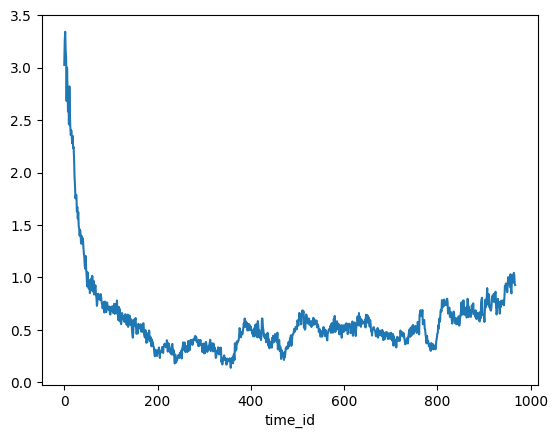

In [61]:
df.iloc[4500000:7000000].loc[df['symbol_id']==15].groupby("time_id").mean().feature_78.plot()

<Axes: xlabel='time_id'>

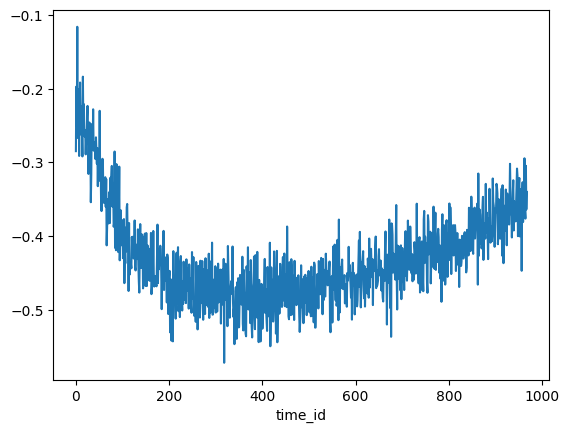

In [ ]:
df_5.loc[df['symbol_id']==13].groupby("time_id").mean().feature_78.plot()

<Axes: xlabel='time_id'>

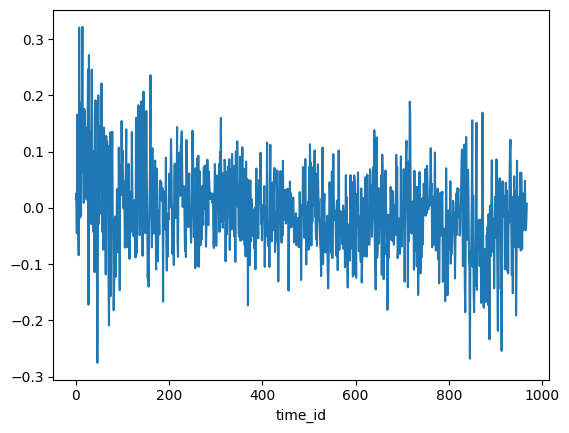

In [33]:
df_5.loc[df['symbol_id']==13].groupby("time_id").mean().responder_6.plot()

<Axes: xlabel='time_id'>

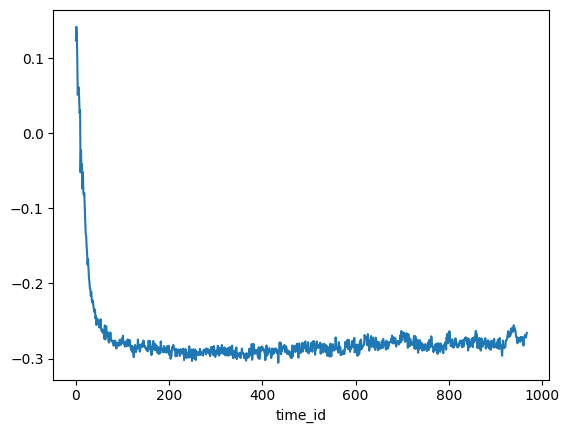

In [30]:
(df_6.loc[df['symbol_id']==13].groupby("time_id").mean().feature_78).plot()

<Axes: xlabel='time_id'>

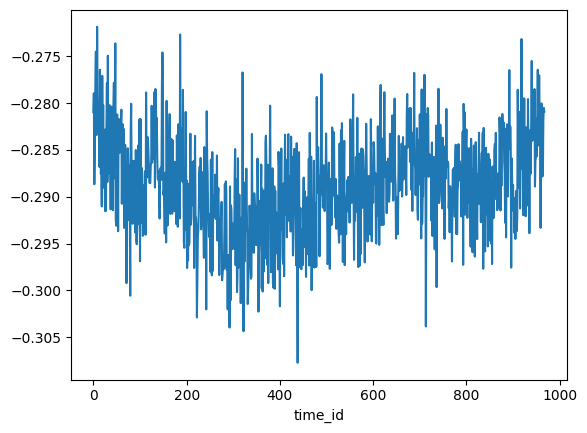

In [9]:
df.loc[df['symbol_id']==0].groupby("time_id").mean().feature_78.plot()

<Axes: xlabel='time_id'>

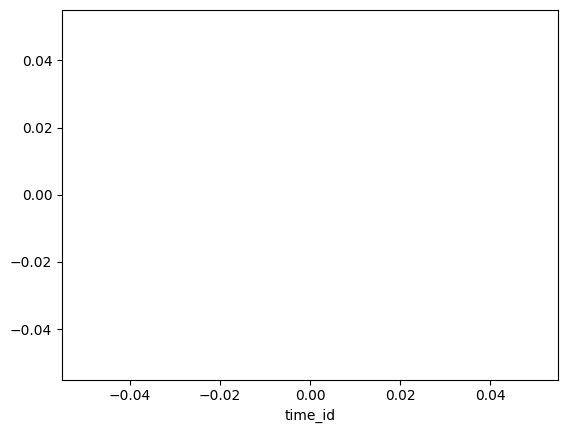

In [180]:
df.loc[df['symbol_id']==50].groupby("time_id").mean().feature_00.plot()

<Axes: xlabel='time_id'>

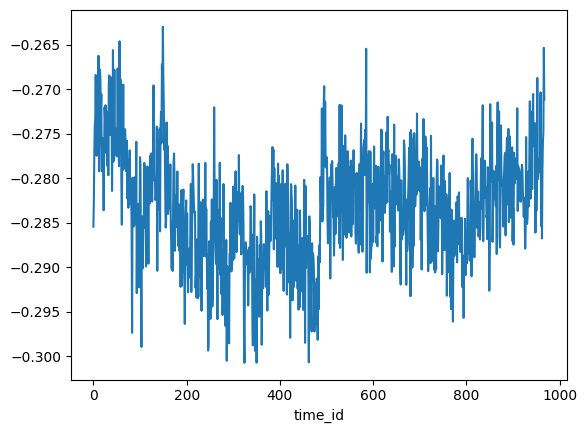

In [57]:
df.loc[df['symbol_id']==16].groupby("time_id").mean().feature_78.plot()

In [ ]:
df['fear']

<Axes: xlabel='time_id'>

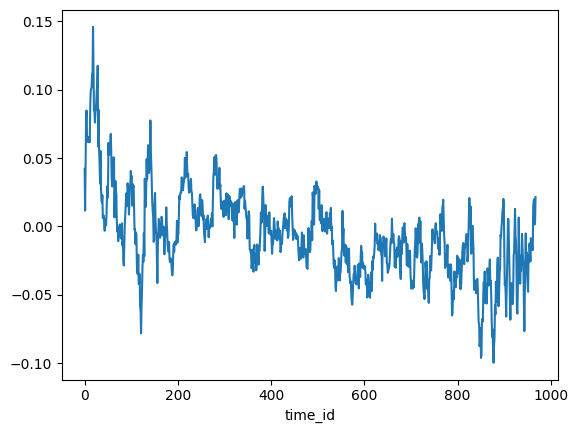

In [16]:
time_df.responder_6.plot()